In [1]:
!pip install seaborn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [36]:
# -*- coding: utf-8 -*-
import sys
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.utils.rnn as rnn_utils
import torch.optim as optim
import torch.nn.utils as utils
import seaborn as sns
import matplotlib.pyplot as plt
import time
import random
from torch.utils import data
from tqdm import tqdm

from torch.utils.data import DataLoader
from torch.nn.utils.rnn import pad_sequence,pack_padded_sequence,pad_packed_sequence


cuda = torch.cuda.is_available()
print(cuda, sys.version)
device = torch.device("cuda" if cuda else "cpu")
np.random.seed(420)
torch.manual_seed(420)

LETTER_LIST = ['<sos>', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 
               'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', '-', "'", '.', '_', '+', ' ', '<eos>']

True 3.7.13 (default, Apr 24 2022, 01:04:09) 
[GCC 7.5.0]


In [4]:
from typing import List, Tuple, Dict
#%%
def create_dictionaries(letter_list: List[str]) -> Tuple[Dict[str, int], Dict[int, str]]:
    '''
    Create dictionaries for letter2index and index2letter transformations
    '''
    letter2index, index2letter = {}, {}
    for i, j in enumerate(letter_list):
      letter2index[j] = i
      index2letter[i] = j
    return (letter2index, index2letter)
    
def transform_letter_to_index(raw_transcripts: List[str]) -> List[List[int]]:
    '''
    Transforms text input to numerical input by converting each letter 
    to its corresponding index from letter_list

    Args:
        raw_transcripts: Raw text transcripts
    
    Return:
        transcripts: Converted index-format transcripts.
    '''  
    transcripts = []
    for raw in raw_transcripts:
        transcripts2index = list(map(lambda x: LETTER_LIST.index(x), raw))
        transcripts.append(transcripts2index)
    return transcripts
    
# Create the letter2index and index2letter dictionary
letter2index, index2letter = create_dictionaries(LETTER_LIST)

In [5]:
%cd /content/drive/MyDrive/Colab Notebooks/DL/hw4p2/hw4p2_toy_dataset

/content/drive/MyDrive/Colab Notebooks/DL/hw4p2/hw4p2_toy_dataset


In [6]:
# Load the training, validation and testing data
train_data = np.load('train.npz', allow_pickle=True, encoding='bytes')['data'] # Training set contains a random sequence of characters, each of variable length and 40 frequency bands.
valid_data = np.load('dev.npz', allow_pickle=True, encoding='bytes')['data'] # Development set contains a random sequence of characters, each of variable length and 40 frequency bands.

# Load the training, validation raw text transcripts
raw_train_transcript = np.load('train_transcripts.npz', allow_pickle=True)['data'] # Transcripts corresponding to the sequences in train.npz. These are arranged in the same order as the sequences.
raw_valid_transcript = np.load('dev_transcripts.npz', allow_pickle=True)['data'] # Transcripts corresponding to the sequences in dev.npz. These are arranged in the same order as the sequences.

# # TODO: Convert the raw text transcripts into indexes
train_transcript = transform_letter_to_index(raw_train_transcript) # A list of list of ints 
valid_transcript = transform_letter_to_index(raw_valid_transcript)

In [7]:
class MyDataset(data.Dataset):
    def __init__(self, X, Y):
        self.X = X
        self.Y = Y

    def __len__(self):
        return self.X.shape[0]

    def __getitem__(self, index):
        # For testing set, return only x
        if self.Y is None:
            return torch.as_tensor(self.X[index])
        # For training and validation set, return x and y
        else:
            return torch.as_tensor(self.X[index]), torch.as_tensor(self.Y[index])

def collate_train_val(data):
    """
    Return:
        pad_x: the padded x (training/validation speech data) 
        pad_y: the padded y (text labels - transcripts)
        x_len: the length of x
        y_len: the length of y
    """
    # Consider batch_first = True
    #data is a list of (x,y)
    x,y = zip(*data)
    pad_x= pad_sequence(x, batch_first=True)
    pad_y= pad_sequence(y, batch_first=True)
    x_len= torch.tensor([len(i) for i in x])
    y_len= torch.tensor([len(i) for i in y])
    return (pad_x, pad_y, x_len, y_len)

# def collate_test(data):
#     """
#     Return:
#         pad_x: the padded x (testing speech data) 
#         x_len: the length of x
#     """
#     # Consider batch_first = True
#     pad_x= pad_sequence(data, batch_first=True)
#     x_len= torch.tensor([len(i) for i in data])
#     return (pad_x, x_len)

In [8]:
# Create datasets
batch_size=64
# Create datasets
train_dataset = MyDataset(train_data, train_transcript)# fill this out
valid_dataset = MyDataset(valid_data, valid_transcript) # fill this out
# test_dataset = MyDataset(test_data, None)# fill this out

# Create data loaders
train_loader = data.DataLoader(dataset=train_dataset, 
                          batch_size=batch_size, 
                          shuffle=True, 
                          collate_fn=collate_train_val,
                          num_workers = 2,
                          pin_memory = True)# fill this out
valid_loader = data.DataLoader(dataset=valid_dataset, 
                          batch_size=1, shuffle=False, 
                          collate_fn=collate_train_val,
                          num_workers = 2,
                          pin_memory = True)# fill this out
# test_loader = data.DataLoader(dataset=test_dataset, 
#                           batch_size=64, shuffle=False, 
#                           collate_fn=collate_train_val,
#                           num_workers = 4,pin_memory = True)

In [13]:
class pBLSTM(nn.Module):
    '''
    Pyramidal BiLSTM
    Read paper and understand the concepts and then write your implementation here.

    At each step,
    1. Pad your input if it is packed
    2. Truncate the input length dimension by concatenating feature dimension
        (i) How should  you deal with odd/even length input? 
        (ii) How should you deal with input length array (x_lens) after truncating the input?
    3. Pack your input
    4. Pass it into LSTM layer

    To make our implementation modular, we pass 1 layer at a time.
    '''
    def __init__(self, input_dim, hidden_dim):
        super(pBLSTM, self).__init__()
        self.blstm = nn.LSTM(input_size=input_dim, 
                             hidden_size=hidden_dim, num_layers=1, 
                             batch_first=True, bidirectional=True)
    def forward(self, x):
        x_unpacked, len_x = pad_packed_sequence(x, batch_first=True)
        # Truncate the input length dimension with odd length input
        seq_len = x_unpacked.shape[1]
        if seq_len % 2:
          x_unpacked = x_unpacked[:, :-1, :]
          len_x = torch.where(len_x == seq_len, seq_len - 1, len_x)
        new_L = x_unpacked.shape[1]//2
        x_reshaped = x_unpacked.reshape(x_unpacked.shape[0], new_L, x_unpacked.shape[2]*2)
        len_x = torch.where(len_x > new_L, new_L, len_x)
        x_pad = pack_padded_sequence(x_reshaped, len_x, batch_first=True, enforce_sorted=False)
        out,_ = self.blstm(x_pad) 
        return out

In [12]:
class Encoder(nn.Module):
    '''
    Encoder takes the utterances as inputs and returns the key, value and unpacked_x_len.

    '''
    def __init__(self, input_dim, encoder_hidden_dim, key_value_size=128):
        super(Encoder, self).__init__()
        # The first LSTM layer at the bottom
        self.lstm = nn.LSTM(input_size=input_dim,
                            hidden_size=encoder_hidden_dim,
                            num_layers=1, batch_first=True,
                            bidirectional=True)

        # Define the blocks of pBLSTMs
        # Dimensions should be chosen carefully
        # Hint: Bidirectionality, truncation...
        self.pBLSTMs = nn.Sequential(
            pBLSTM(input_dim=encoder_hidden_dim*4, hidden_dim=encoder_hidden_dim),
            pBLSTM(input_dim=encoder_hidden_dim*4, hidden_dim=encoder_hidden_dim),
            pBLSTM(input_dim=encoder_hidden_dim*4, hidden_dim=encoder_hidden_dim)
        )
         
        # Optional: The linear transformations for producing Key and Value for attention
        # Hint: Dimensions when bidirectional lstm? 
        self.key_network = nn.Linear(encoder_hidden_dim*2, key_value_size)
        self.value_network = nn.Linear(encoder_hidden_dim*2, key_value_size)
    def forward(self, x, x_len):
        """
        1. Pack your input and pass it through the first LSTM layer (no truncation)
        2. Pass it through the pyramidal LSTM layer
        3. Pad your input back to (B, T, *) or (T, B, *) shape
        4. Output Key, Value, and truncated input lens

        Key and value could be
            (i) Concatenated hidden vectors from all time steps (key == value).
            (ii) Linear projections of the output from the last pBLSTM network.
                If you choose this way, you can use the final output of
                your pBLSTM network.
        """
        
        pack_x = pack_padded_sequence(x, x_len, batch_first=True, enforce_sorted=False)
        out,_ = self.lstm(pack_x)
        # out = self.pBLSTMs(out) # Not using pNLSTM 
        out_packed, len_out = pad_packed_sequence(out, batch_first=True)
        key = self.key_network(out_packed)
        value = self.value_network(out_packed)
        return key, value, len_out

In [15]:
def plot_attention(attention):
    # utility function for debugging
    plt.clf()
    sns.heatmap(attention, cmap='GnBu')
    plt.show()

class Attention(nn.Module):
    '''
    Attention is calculated using key and value from encoder and query from decoder.
    Here are different ways to compute attention and context:
    1. Dot-product attention
        energy = bmm(key, query) 
        # Optional: Scaled dot-product by normalizing with sqrt key dimension
        # Check "attention is all you need" Section 3.2.1
    * 1st way is what most TAs are comfortable with, but if you want to explore...
    2. Cosine attention
        energy = cosine(query, key) # almost the same as dot-product xD 
    3. Bi-linear attention
        W = Linear transformation (learnable parameter): d_k -> d_q
        energy = bmm(key @ W, query)
    4. Multi-layer perceptron
        # Check "Neural Machine Translation and Sequence-to-sequence Models: A Tutorial" Section 8.4
    
    After obtaining unnormalized attention weights (energy), compute and return attention and context, i.e.,
    energy = mask(energy) # mask out padded elements with big negative number (e.g. -1e9)
    attention = softmax(energy)
    context = bmm(attention, value)

    5. Multi-Head Attention
        # Check "attention is all you need" Section 3.2.2
        h = Number of heads
        W_Q, W_K, W_V: Weight matrix for Q, K, V (h of them in total)
        W_O: d_v -> d_v

        Reshape K: (B, T, d_k)
        to (B, T, h, d_k // h) and transpose to (B, h, T, d_k // h)
        Reshape V: (B, T, d_v)
        to (B, T, h, d_v // h) and transpose to (B, h, T, d_v // h)
        Reshape Q: (B, d_q)
        to (B, h, d_q // h)

        energy = Q @ K^T
        energy = mask(energy)
        attention = softmax(energy)
        multi_head = attention @ V
        multi_head = multi_head reshaped to (B, d_v)
        context = multi_head @ W_O
    '''
    def __init__(self):
        super(Attention, self).__init__()
        # Optional: dropout

    def forward(self, query, key, value, mask):
        """
        input:
            key: (batch_size, seq_len, d_k)
            value: (batch_size, seq_len, d_v)
            query: (batch_size, d_q)
        * Hint: d_k == d_v == d_q is often true if you use linear projections
        return:
            context: (batch_size, key_val_dim)
        
        """
        out = torch.bmm(key, query.unsqueeze(2)).squeeze(2) # Compute the energy of the attention, (batch_size, seq_len)
        out.masked_fill_(mask, -(1e9))
        
        attention = F.softmax(out, dim=1)
        
        context = torch.bmm(attention.unsqueeze(1), value).squeeze(1) # conpute the context, (batch_size, d_v)
        return context, attention      
        # we return attention weights for plotting (for debugging)

In [16]:
class Decoder(nn.Module):
    '''
    As mentioned in a previous recitation, each forward call of decoder deals with just one time step.
    Thus we use LSTMCell instead of LSTM here.
    The output from the last LSTMCell can be used as a query for calculating attention.
    Methods like Gumble noise and teacher forcing can also be incorporated for improving the performance.
    '''
    def __init__(self, vocab_size, decoder_hidden_dim, embed_dim, key_value_size=128):
        super(Decoder, self).__init__()
        # Hint: Be careful with the padding_idx
        self.embedding = nn.Embedding(vocab_size, 
                                      embedding_dim=embed_dim, 
                                      padding_idx=0)
        # The number of cells is defined based on the paper
        self.lstm1 = nn.LSTMCell(embed_dim + key_value_size, decoder_hidden_dim) # Context ci−1 is be used as an extra input by concatenated with the input
        self.lstm2 = nn.LSTMCell(decoder_hidden_dim, key_value_size)
    
        self.attention = Attention()     
        self.vocab_size = vocab_size
      
        self.character_prob = nn.Linear(2*key_value_size, vocab_size) #: 2*d_v -> vocab_size
          # Optional: Weight-tying
        self.key_value_size = key_value_size
        
        # Weight tying
        self.character_prob.weight = self.embedding.weight

    def forward(self, key, value, encoder_len, y=None, mode='train'):
        '''
        Args:
            key :(B, T, d_k) - Output of the Encoder (possibly from the Key projection layer)
            value: (B, T, d_v) - Output of the Encoder (possibly from the Value projection layer)
            y: (B, text_len) - Batch input of text with text_length
            mode: Train or eval mode for teacher forcing
        Return:
            predictions: the character perdiction probability 
        '''

        B, key_seq_max_len, key_value_size = key.shape

        if mode == 'train':
            max_len =  y.shape[1]
            char_embeddings = self.embedding(y) # (B, text_len, embed_dim)
        else:
            max_len = 600

        # TODO: Create the attention mask here (outside the for loop rather than inside) to aviod repetition
        mask = torch.arange(key_seq_max_len).unsqueeze(0) >= encoder_len.unsqueeze(1)
        mask = mask.to(device)
        
        predictions = []
        # This is the first input to the decoder
        # What should the fill_value be?
        prediction = torch.full((B, 1), fill_value=0, device=device)
        # The length of hidden_states vector should depend on the number of LSTM Cells defined in init
        # The paper uses 2
        hidden_states = [None, None] 
        
        # TODO: Initialize the context
        context = value[:, 0, :]# fill this out

        attention_plot = [] # this is for debugging

        for i in range(max_len):
            if mode == 'train':
                # TODO: Implement Teacher Forcing
                """
                if using teacher_forcing:
                    if i == 0:
                        # This is the first time step
                        # Hint: How did you initialize "prediction" variable above?
                    else:
                        # Otherwise, feed the label of the **previous** time step
                else:
                    char_embed = embedding of the previous prediction
                """                 
                rate = random.random()
                teacher_forcing = True if rate > 0.1 else False
                if teacher_forcing:
                    if i == 0:
                            init = torch.zeros(B, dtype=torch.long).fill_(letter2index['<sos>']).to(device)
                            char_embed=self.embedding(init)
                    else:
                        char_embed = self.embedding(y[:,i])
                else:
                    char_embed=self.embedding(prediction.argmax(dim=-1))
            else:
                if i == 0:
                    init = torch.zeros(B, dype=torch.long).fill_(letter2index['<sos>']).to(device)
                    char_embed = self.embedding(init)
                else:
                    char_embed = self.embedding(prediction.argmax(dim=-1)) # embedding of the previous prediction
            
            # what vectors should be concatenated as a context?
            y_context = torch.cat([char_embed, context], dim=1)
            # context and hidden states of lstm 1 from the previous time step should be fed
            hidden_states[0] = self.lstm1(y_context, hidden_states[0])

            # hidden states of lstm1 and hidden states of lstm2 from the previous time step should be fed
            hidden_states[1] = self.lstm2(hidden_states[0][0], hidden_states[1])
            # What then is the query?
            query = hidden_states[1][0]
            
            # Compute attention from the output of the second LSTM Cell
            context, attention = self.attention(query, key, value, mask)
            # We store the first attention of this batch for debugging
            attention_plot.append(attention[0].detach().cpu())
            
            # What should be concatenated as the output context?
            output_context = torch.cat([query, context], dim=1)
            prediction = self.character_prob(output_context)
            # store predictions
            predictions.append(prediction.unsqueeze(1))
        
        # Concatenate the attention and predictions to return
        attentions = torch.stack(attention_plot, dim=0)
        predictions = torch.cat(predictions, dim=1)
        return predictions, attentions
#%%

In [17]:
class Seq2Seq(nn.Module):
    '''
    We train an end-to-end sequence to sequence model comprising of Encoder and Decoder.
    This is simply a wrapper "model" for your encoder and decoder.
    '''
    def __init__(self, input_dim, vocab_size, encoder_hidden_dim=256, decoder_hidden_dim=512, embed_dim=256, key_value_size=128):
        super().__init__()
        self.encoder = Encoder(input_dim, encoder_hidden_dim, key_value_size)
        self.decoder = Decoder(vocab_size, decoder_hidden_dim, embed_dim, key_value_size)

    def forward(self, x, x_len, y=None, mode='train'):
        key, value, encoder_len = self.encoder(x, x_len)
        predictions, attentions = self.decoder(key, value, encoder_len, y=y, mode=mode)
        return predictions, attentions

In [33]:
def train(model, train_loader, criterion, optimizer, mode):
    model.train()
    running_loss = 0
    
    
    for i, (x, y, x_len, y_len) in enumerate(train_loader):
        # x, x_len, y = batch
        x, y = x.to(device), y.to(device)
        optimizer.zero_grad()
        predictions, attentions = model(x, x_len, y, mode=mode)
        y_len = y_len.to(device)
        # Generate a mask based on target length. This is to mark padded elements
        # so that we can exclude them from computing loss
        ymax_len = torch.max(y_len)
        mask = (torch.arange(0, ymax_len).repeat(y_len.size(0), 1).to(device) < y_len.unsqueeze(1).expand(y_len.size(0), ymax_len)).int()# fill this out
            
        # Make sure you have the correct shape of predictions when putting into criterion
        loss =  criterion(predictions.view(-1, predictions.shape[2]),y.view(-1))
        # Use the mask you defined above to compute the average loss
        masked_loss = torch.sum(loss * mask.view(-1)) / torch.sum(mask)

        # backprop
        masked_loss.backward()
        
        optimizer.step() 
        # Optional: Gradient clipping

        # When computing Levenshtein distance, make sure you truncate prediction/target

        # Optional: plot your attention for debugging
        # plot_attention(attentions)
        
def val(model, valid_loader):
    model.eval()
    attention_list = []
    for i, (x, y, x_len, y_len) in enumerate(valid_loader):
        x, y = x.to(device), y.to(device)
        predictions, attentions = model(x, x_len, y, mode=mode)
        plot_attention(attentions)
        attention_list.append(attentions)
    return attention_list

  0%|          | 0/50 [00:00<?, ?it/s]

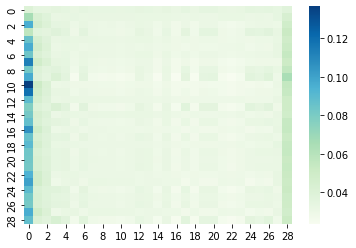

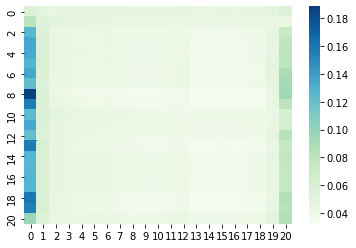

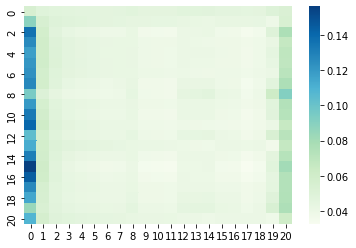

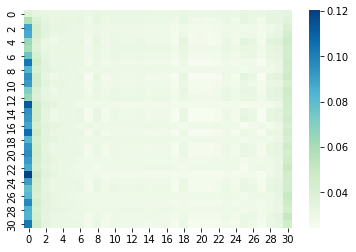

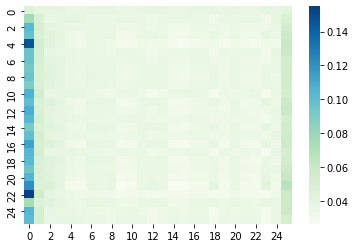

...

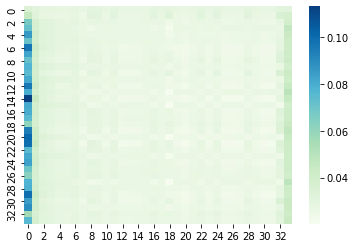

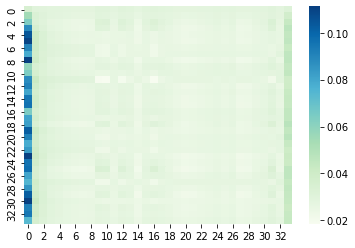

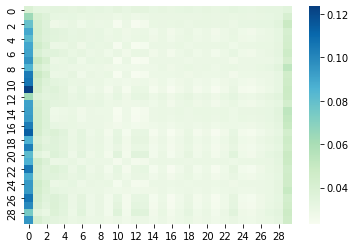

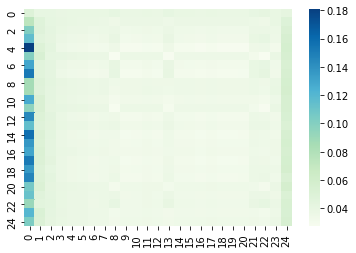

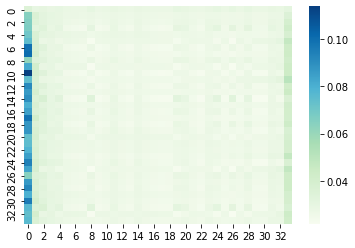

  2%|▏         | 1/50 [00:39<32:01, 39.21s/it]

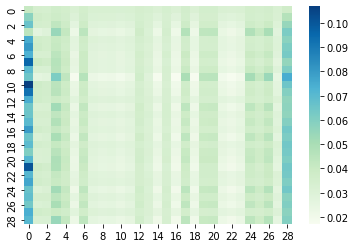

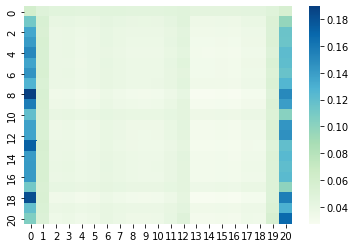

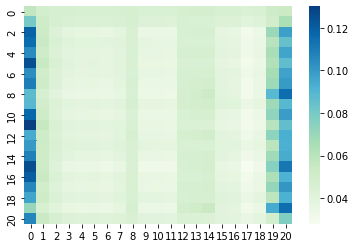

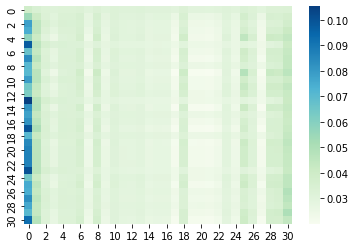

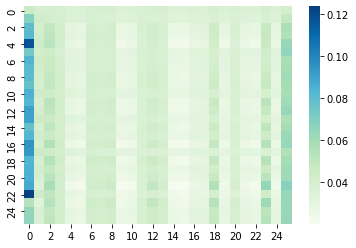

...

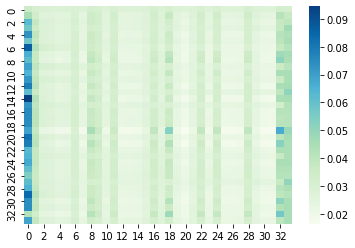

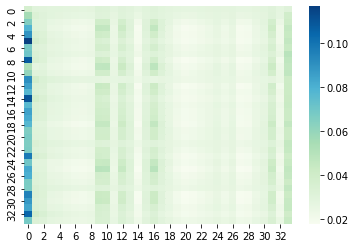

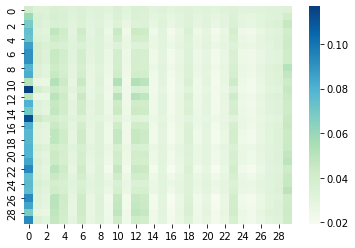

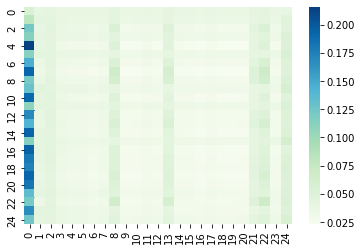

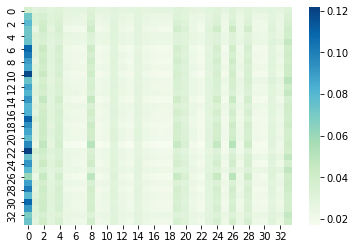

  4%|▍         | 2/50 [01:18<31:20, 39.17s/it]

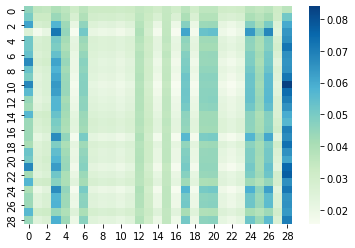

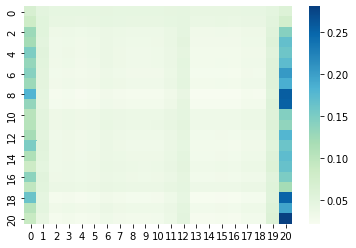

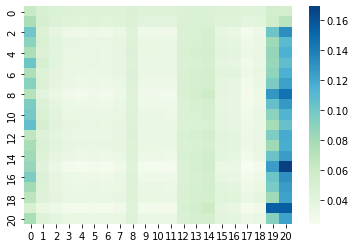

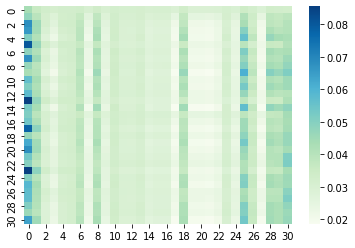

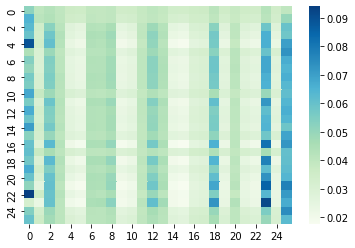

...

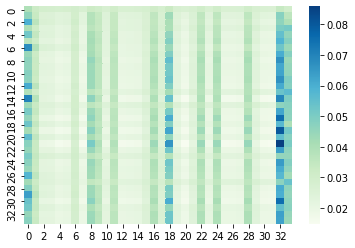

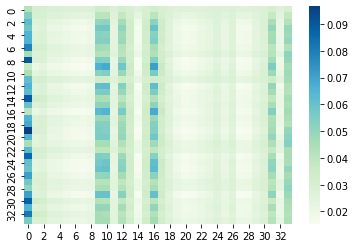

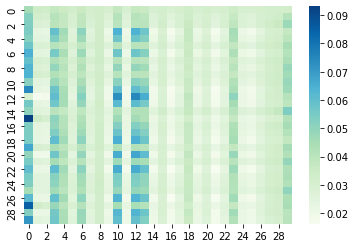

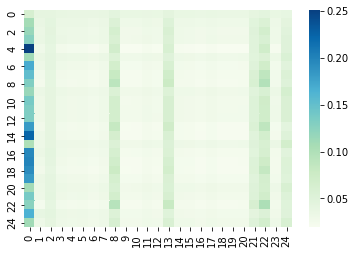

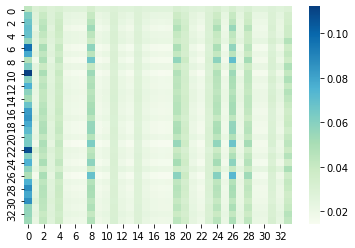

  6%|▌         | 3/50 [01:57<30:33, 39.01s/it]

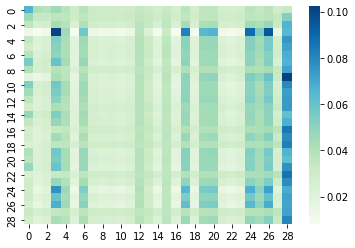

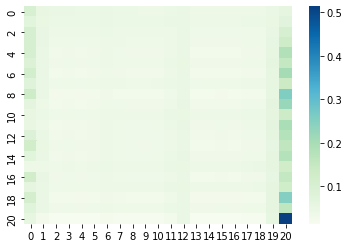

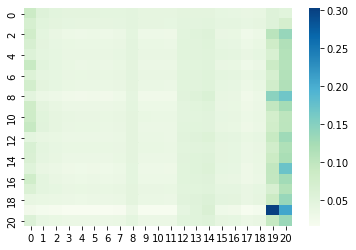

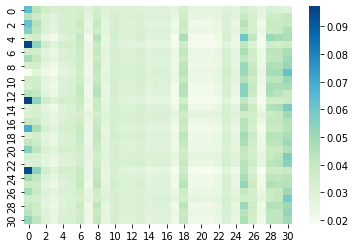

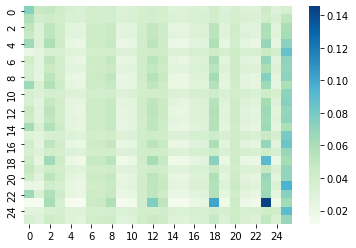

...

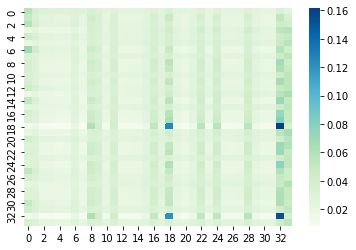

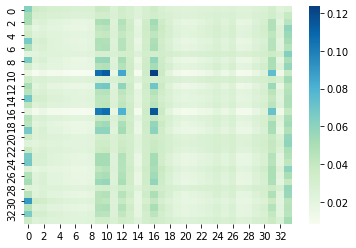

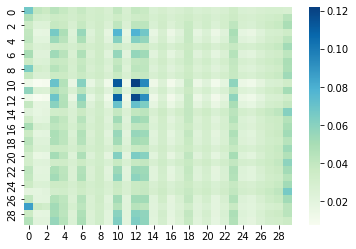

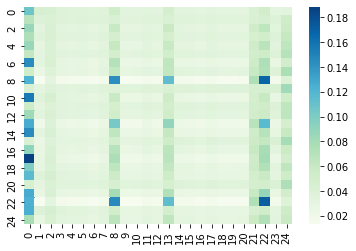

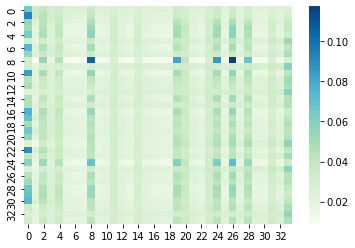

  8%|▊         | 4/50 [02:38<30:35, 39.90s/it]

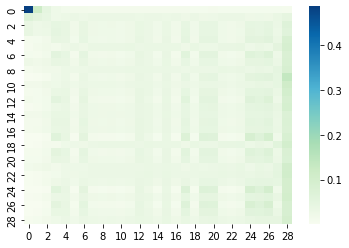

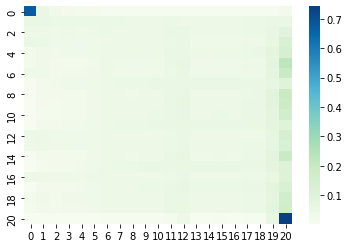

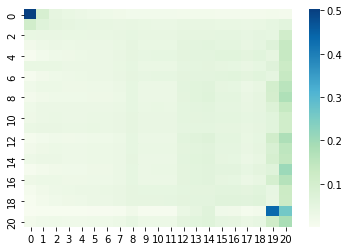

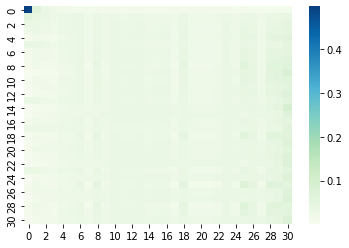

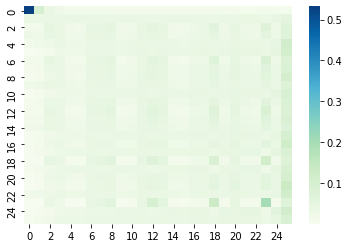

...

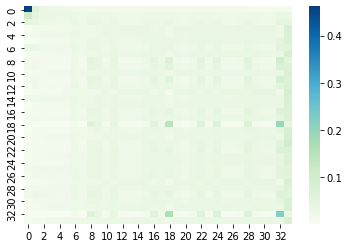

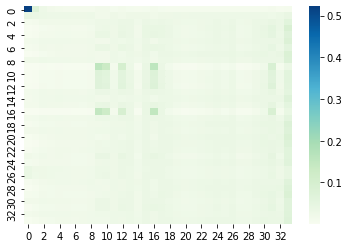

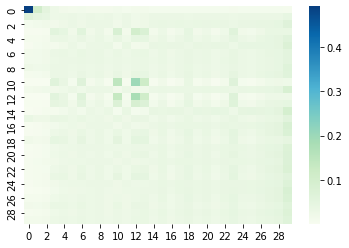

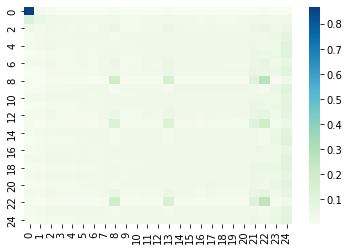

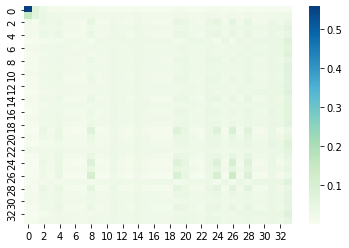

 10%|█         | 5/50 [03:18<30:05, 40.11s/it]

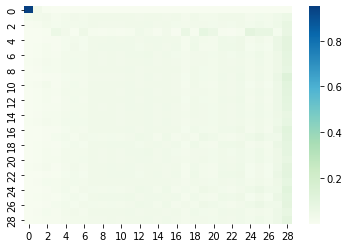

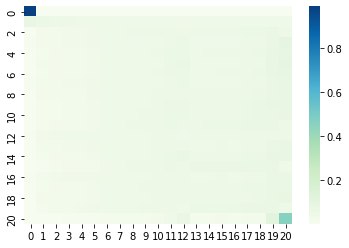

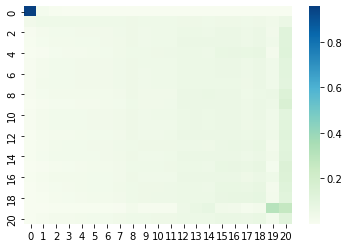

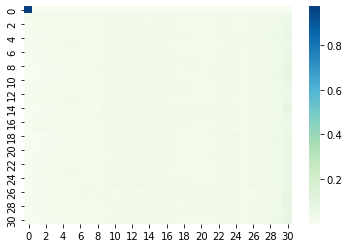

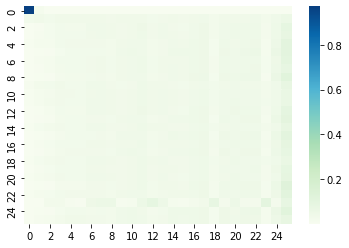

...

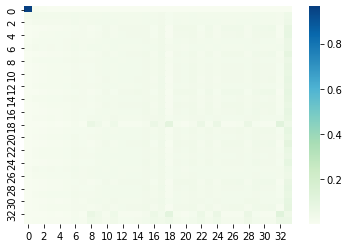

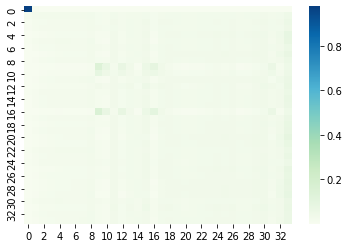

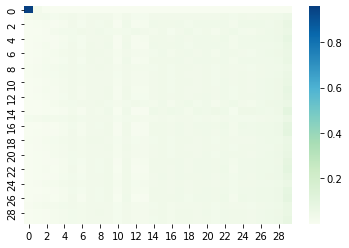

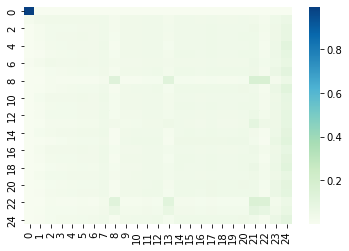

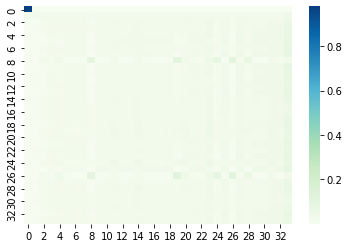

 12%|█▏        | 6/50 [03:59<29:26, 40.14s/it]

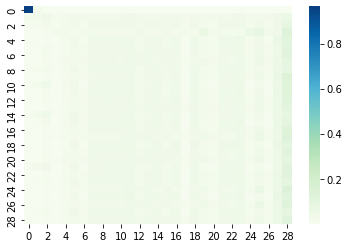

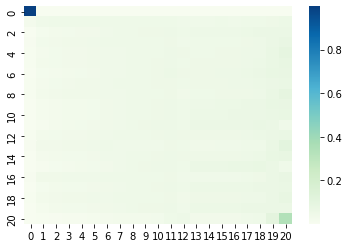

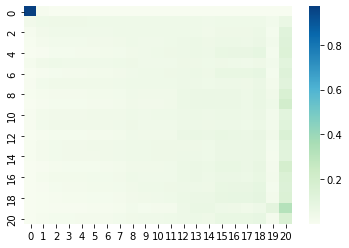

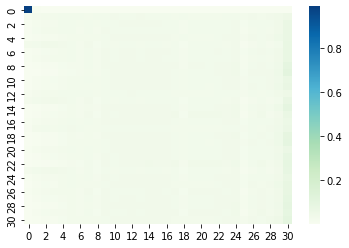

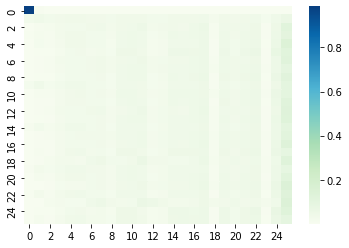

...

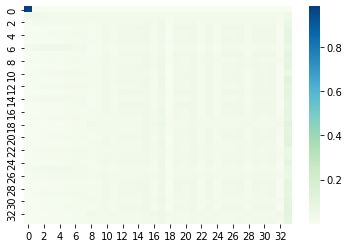

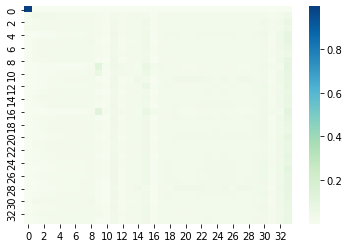

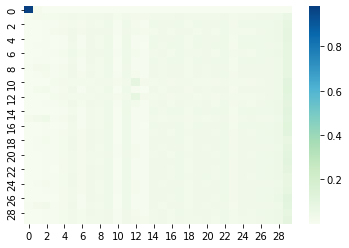

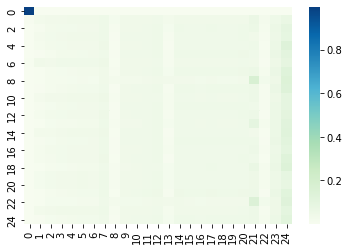

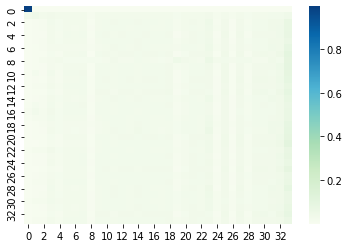

 14%|█▍        | 7/50 [04:40<29:00, 40.49s/it]

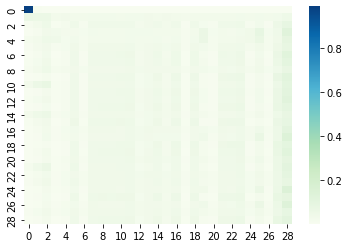

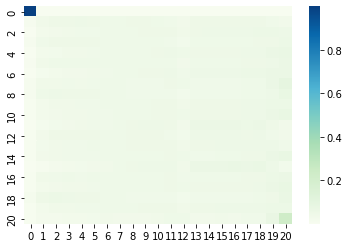

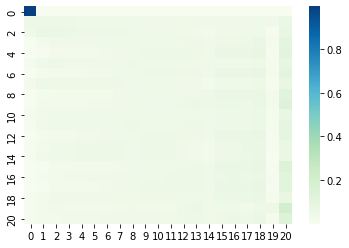

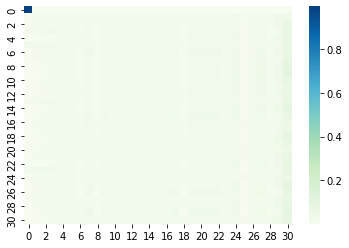

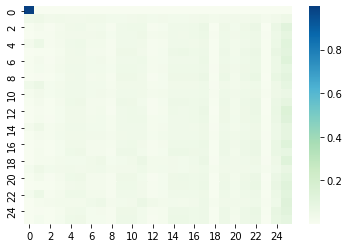

...

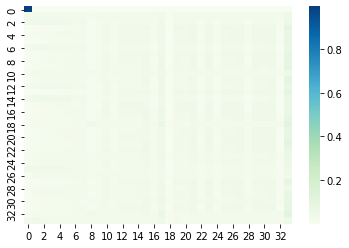

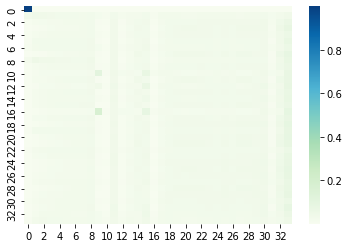

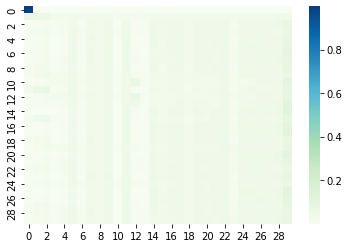

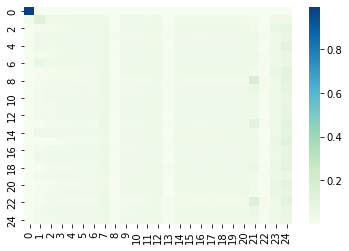

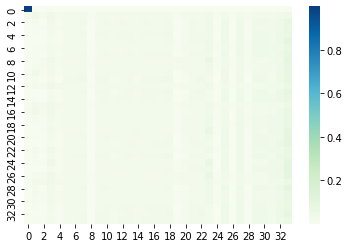

 16%|█▌        | 8/50 [05:20<28:18, 40.45s/it]

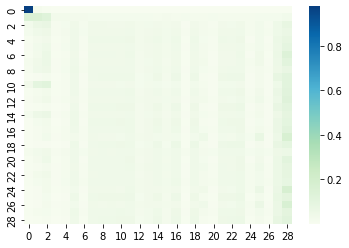

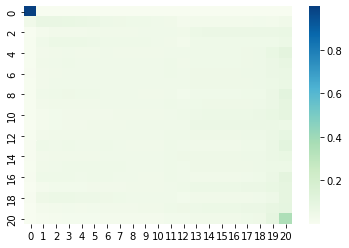

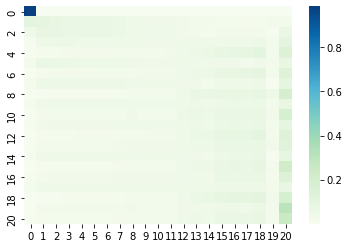

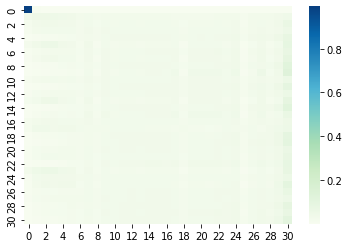

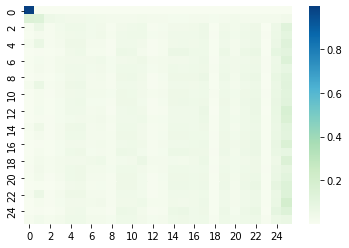

...

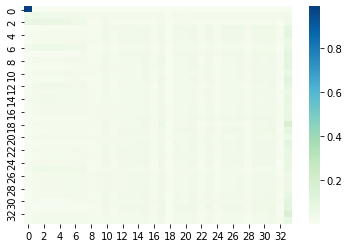

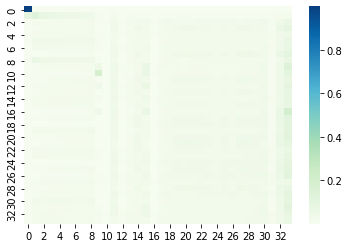

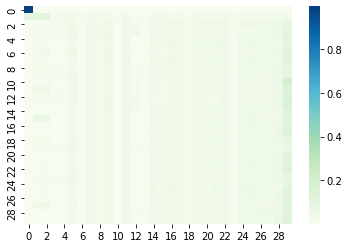

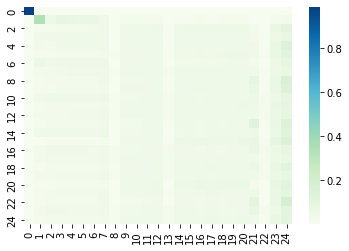

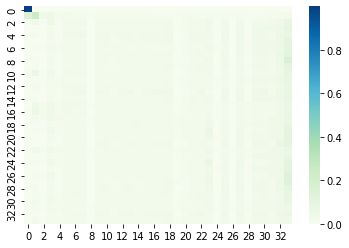

 18%|█▊        | 9/50 [06:01<27:44, 40.60s/it]

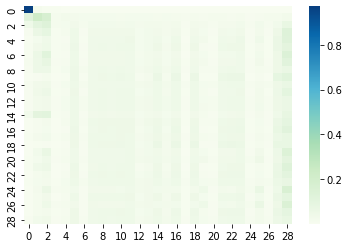

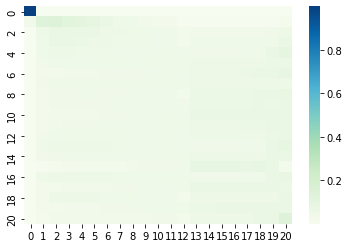

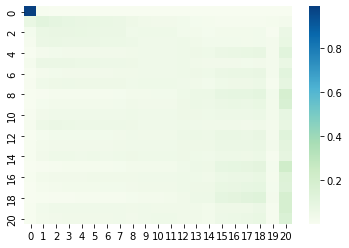

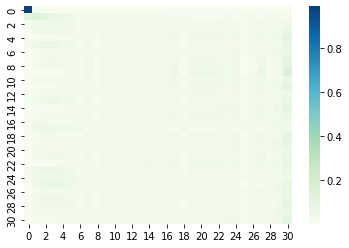

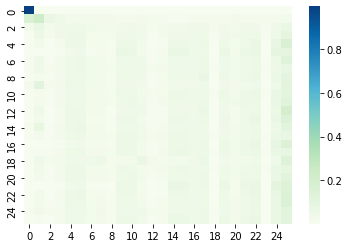

...

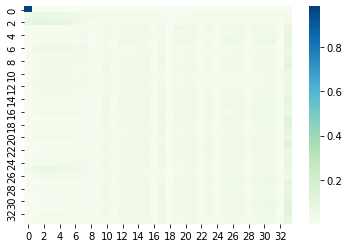

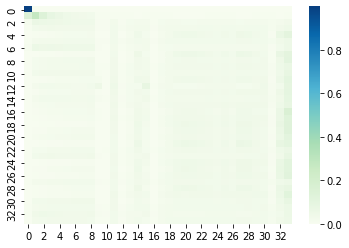

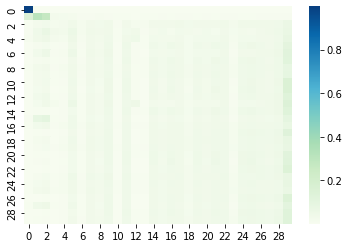

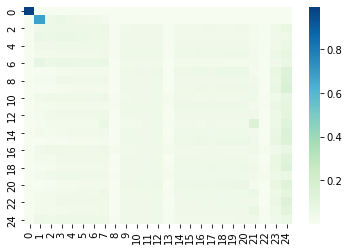

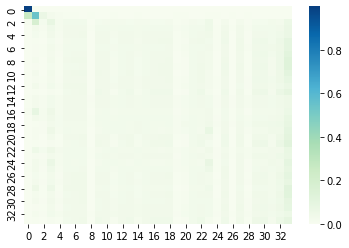

 20%|██        | 10/50 [06:44<27:26, 41.16s/it]

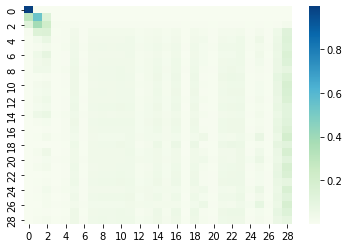

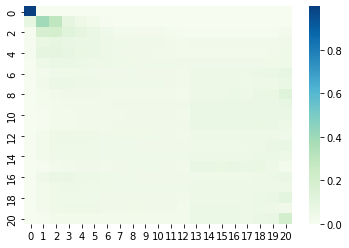

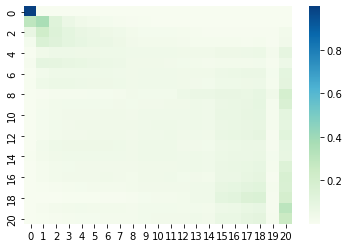

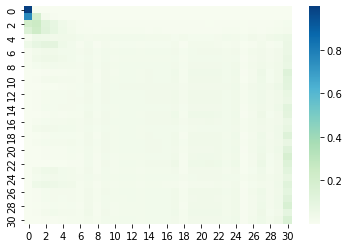

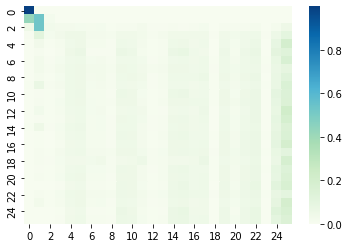

...

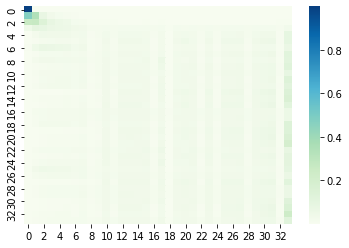

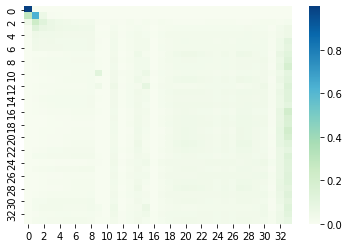

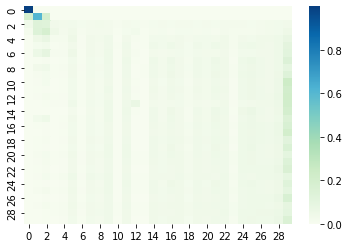

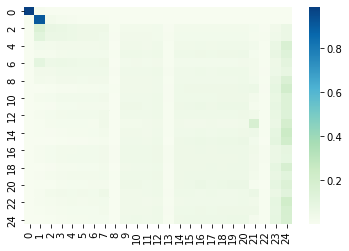

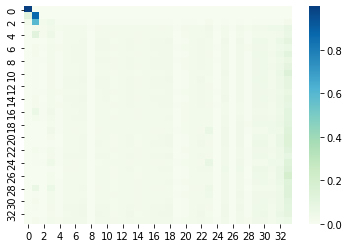

 22%|██▏       | 11/50 [07:25<26:51, 41.32s/it]

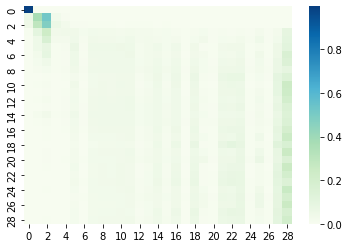

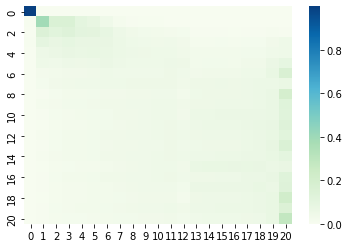

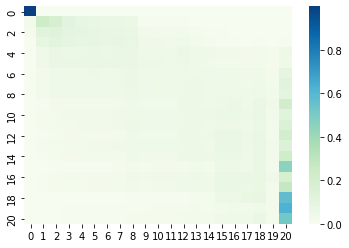

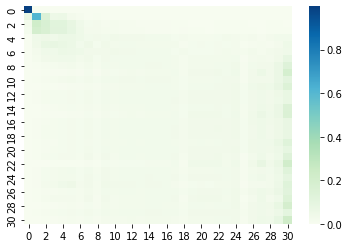

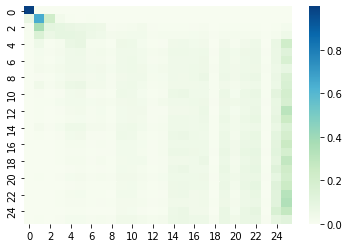

...

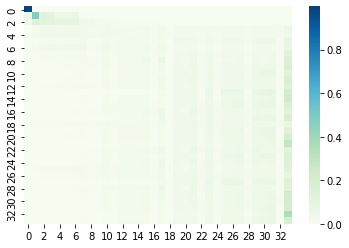

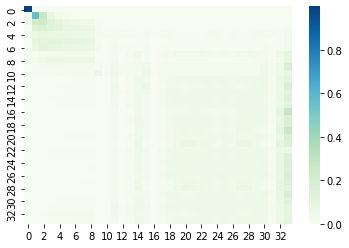

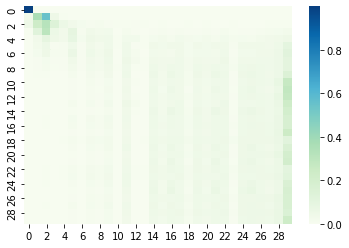

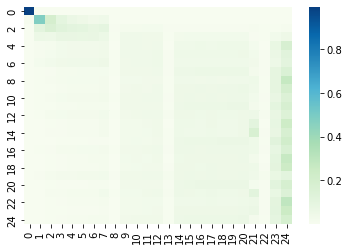

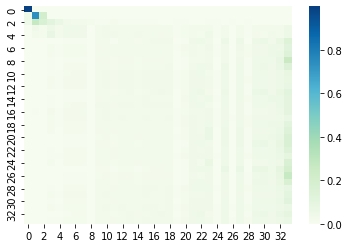

 24%|██▍       | 12/50 [08:09<26:36, 42.02s/it]

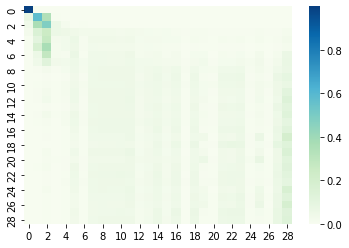

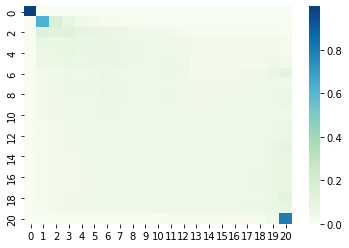

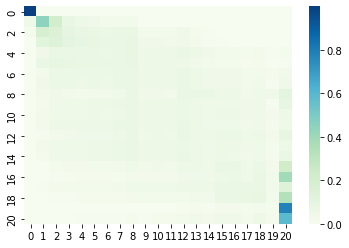

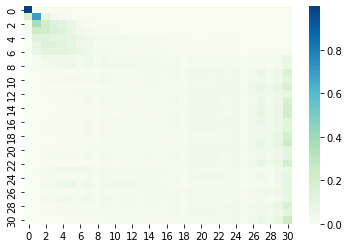

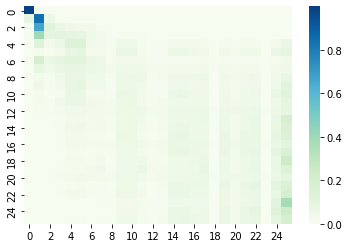

...

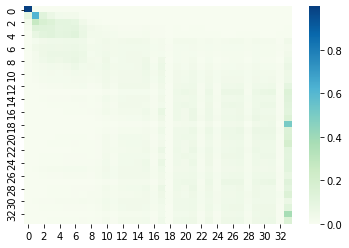

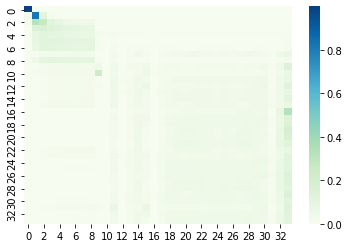

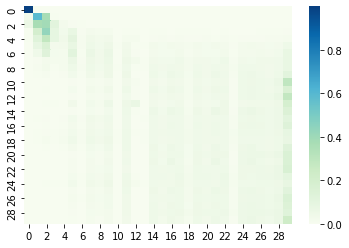

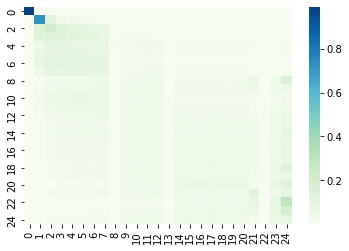

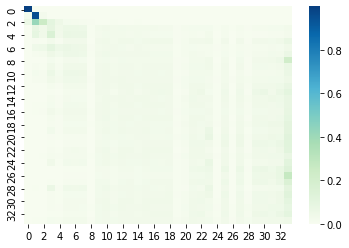

 26%|██▌       | 13/50 [08:52<26:08, 42.39s/it]

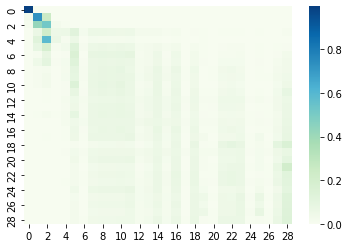

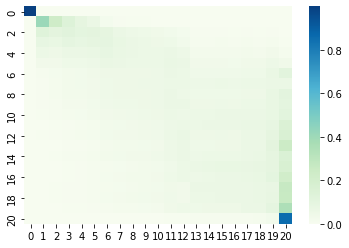

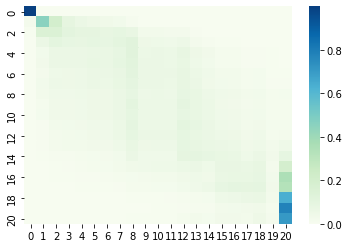

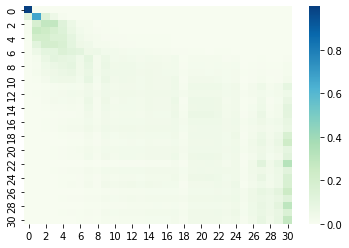

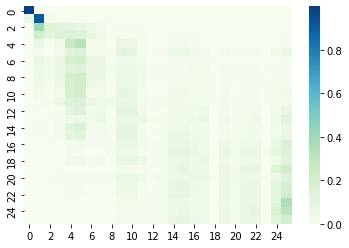

...

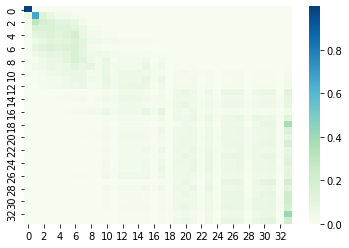

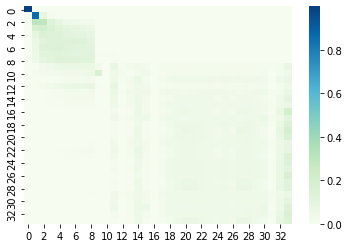

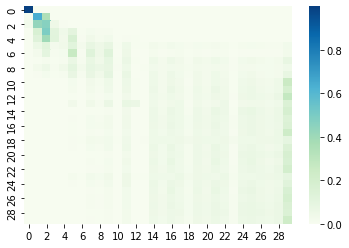

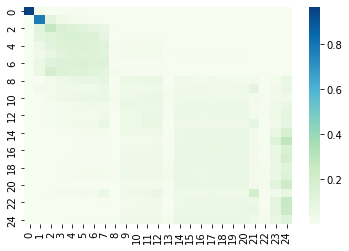

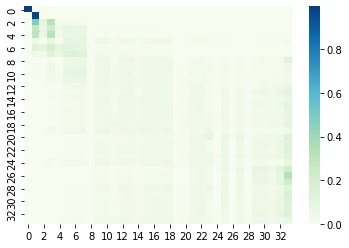

 28%|██▊       | 14/50 [09:36<25:39, 42.77s/it]

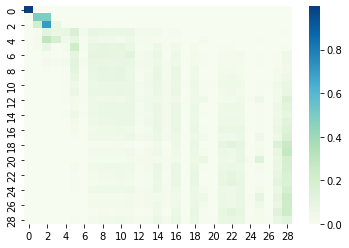

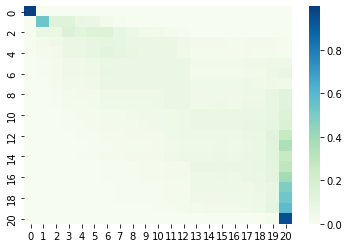

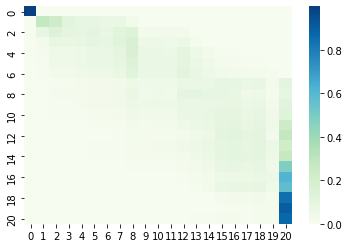

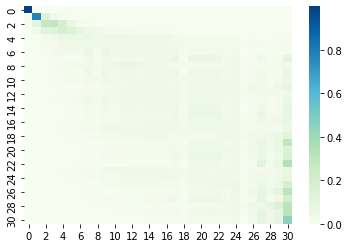

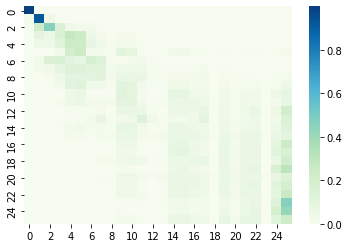

...

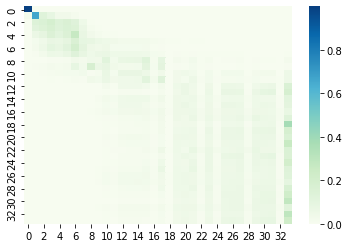

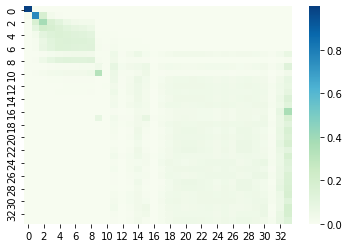

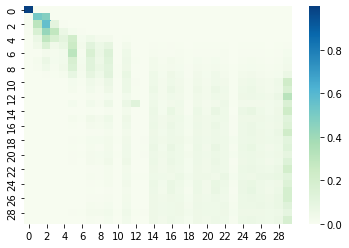

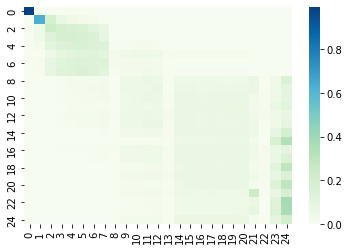

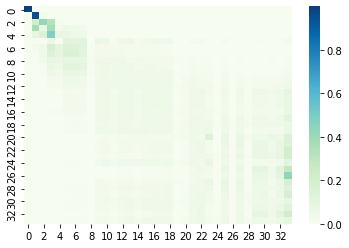

 30%|███       | 15/50 [10:21<25:20, 43.44s/it]

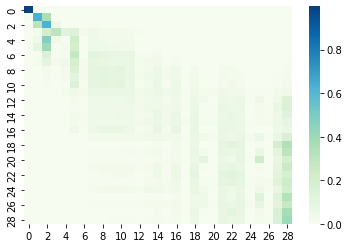

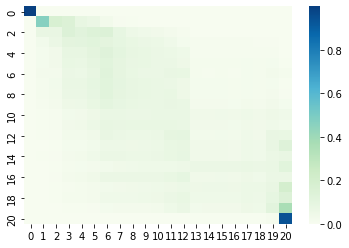

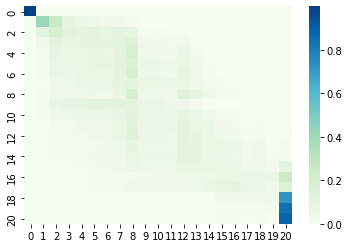

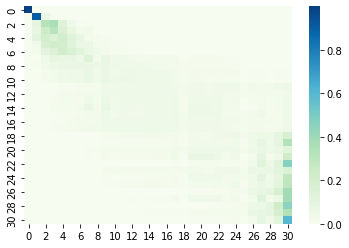

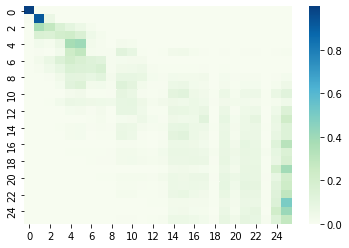

...

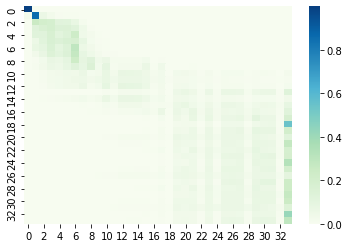

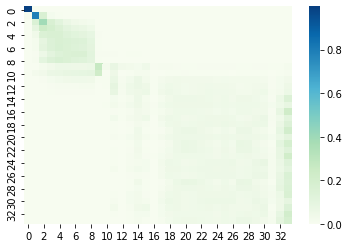

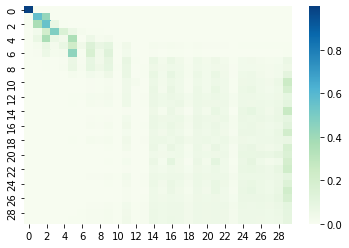

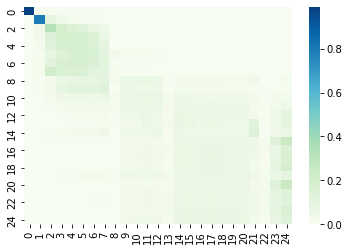

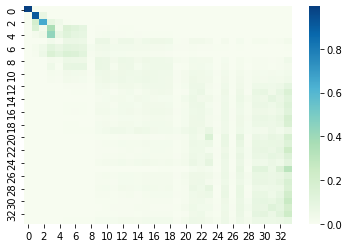

 32%|███▏      | 16/50 [11:05<24:45, 43.68s/it]

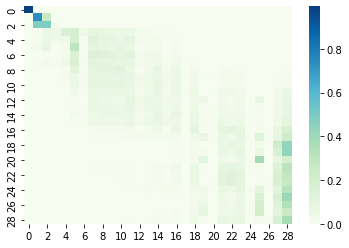

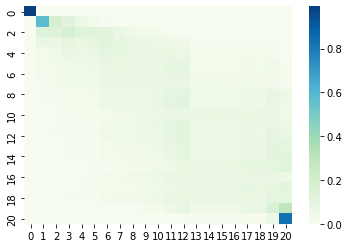

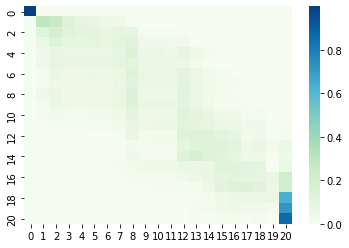

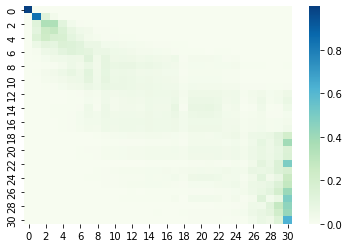

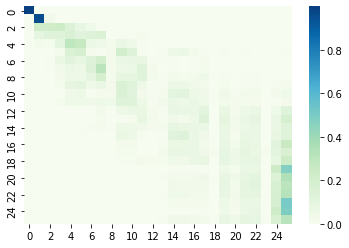

...

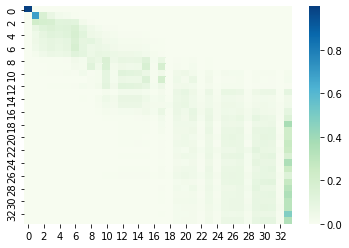

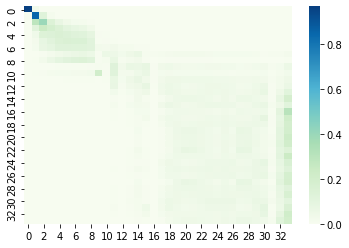

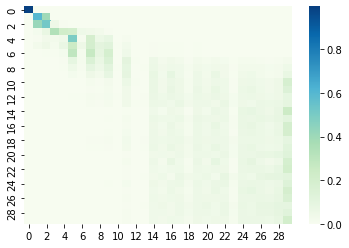

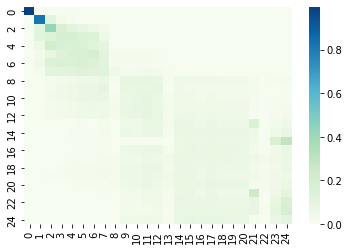

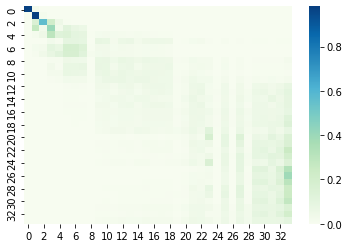

 34%|███▍      | 17/50 [11:50<24:16, 44.15s/it]

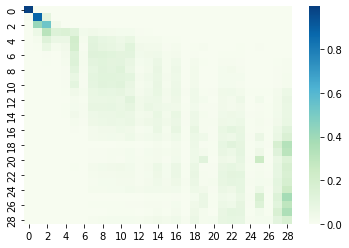

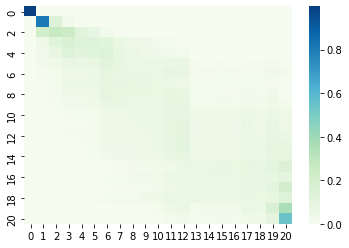

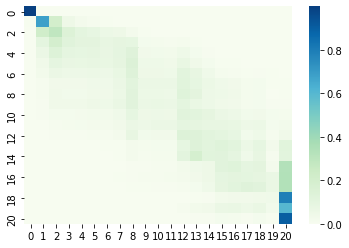

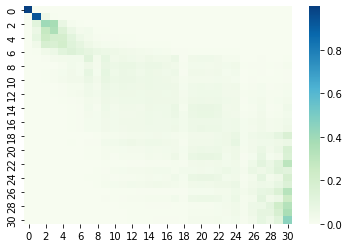

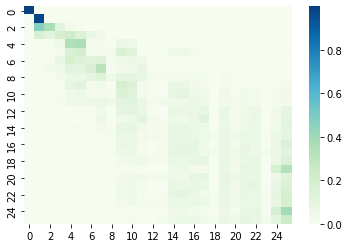

...

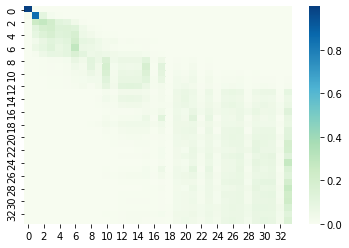

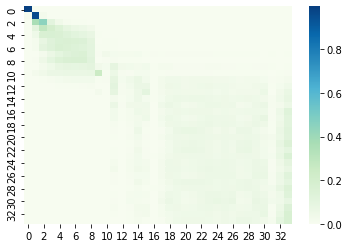

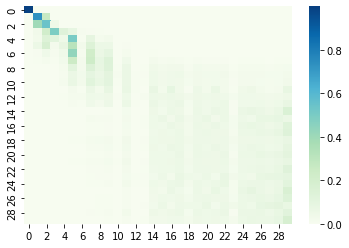

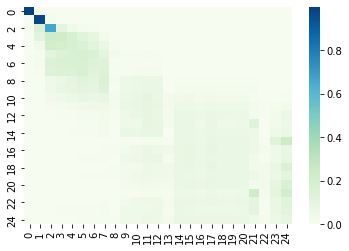

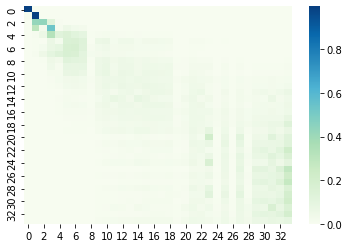

 36%|███▌      | 18/50 [12:37<23:55, 44.86s/it]

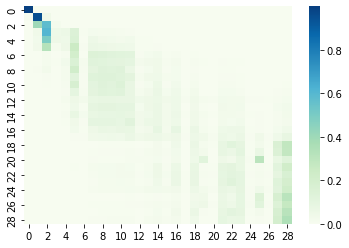

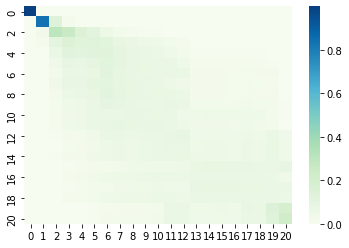

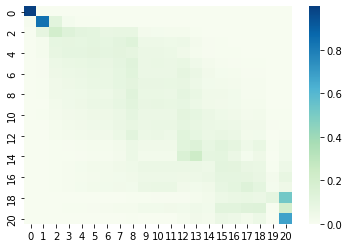

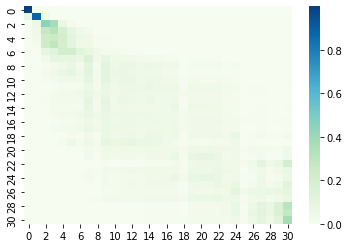

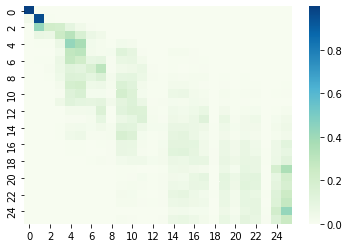

...

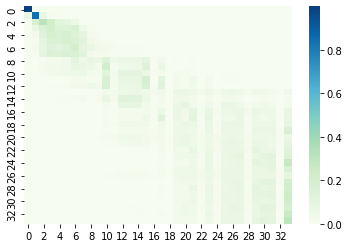

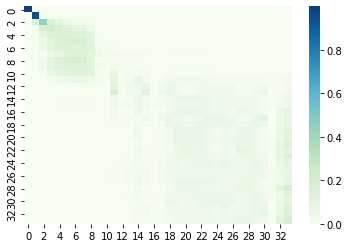

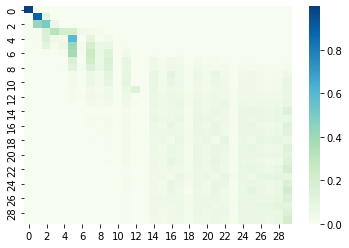

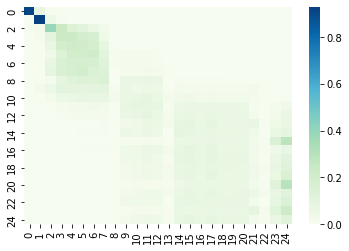

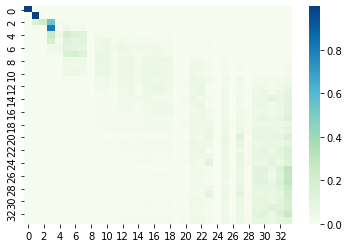

 38%|███▊      | 19/50 [13:22<23:18, 45.12s/it]

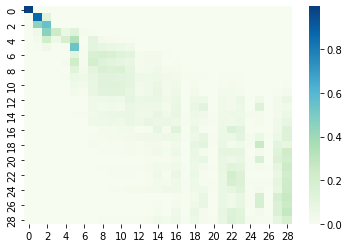

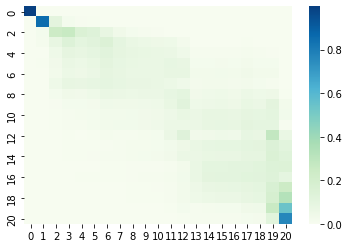

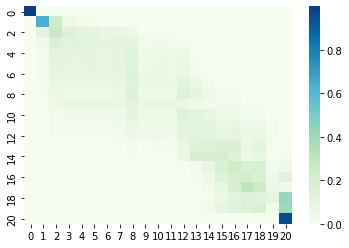

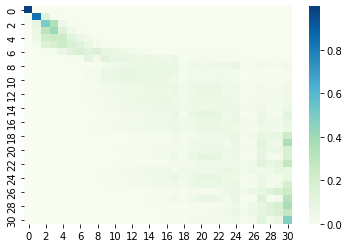

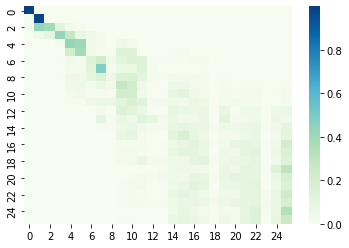

...

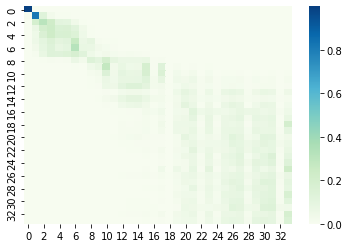

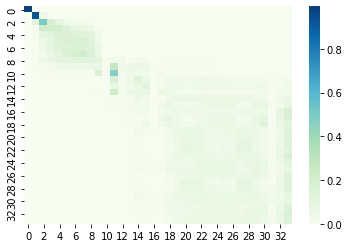

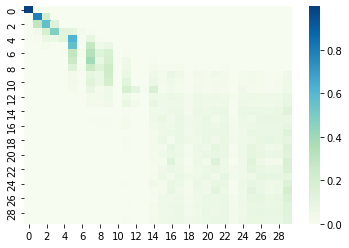

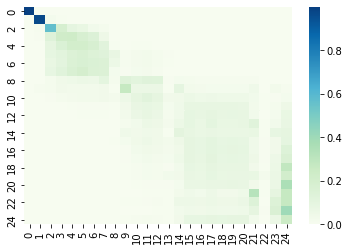

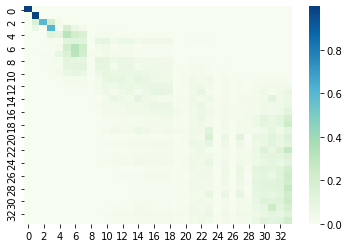

 40%|████      | 20/50 [14:10<22:51, 45.72s/it]

 42%|████▏     | 21/50 [14:57<22:20, 46.22s/it]

 44%|████▍     | 22/50 [15:46<21:56, 47.03s/it]

 46%|████▌     | 23/50 [16:33<21:12, 47.12s/it]

 48%|████▊     | 24/50 [17:21<20:32, 47.40s/it]

 50%|█████     | 25/50 [18:11<20:02, 48.09s/it]

 52%|█████▏    | 26/50 [19:00<19:20, 48.34s/it]

 54%|█████▍    | 27/50 [19:50<18:41, 48.76s/it]

 56%|█████▌    | 28/50 [20:39<17:57, 48.96s/it]

 58%|█████▊    | 29/50 [21:30<17:20, 49.55s/it]

 60%|██████    | 30/50 [22:21<16:42, 50.12s/it]

 62%|██████▏   | 31/50 [23:12<15:53, 50.18s/it]

 64%|██████▍   | 32/50 [24:05<15:17, 50.96s/it]

 66%|██████▌   | 33/50 [24:56<14:28, 51.12s/it]

 68%|██████▊   | 34/50 [25:49<13:46, 51.68s/it]

 68%|██████▊   | 34/50 [26:04<12:16, 46.01s/it]


KeyboardInterrupt: ignored

In [38]:
# TODO: Define your model and put it on the device here
vocab_size = len(LETTER_LIST)
input_dim = 40

model = Seq2Seq(input_dim, vocab_size)
model.to(device)

n_epochs = 30
optimizer = optim.Adam(model.parameters(), lr=0.001)
# Make sure you understand the implication of setting reduction = 'none'
criterion = nn.CrossEntropyLoss(reduction='none')
mode = 'train'

for epoch in tqdm(range(n_epochs)):
    train(model, train_loader, criterion, optimizer, mode)
    attention_list = val(model, valid_loader)


In [ ]:
result = [attention.detach().numpy().T for attention in attention_list[:10]]
np.save('attention.npy', result)